<a href="https://colab.research.google.com/github/A-b-h-i-s-h-e-k-Github-K-u-m-a-r/Deep_Learning_Project/blob/main/mHealth.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#@title Importing required packages
import sys
import os
import re
import pandas as pd
import tensorflow as tf
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
#@title Fetching MHealth
# MHEALTH
! wget http://archive.ics.uci.edu/ml/machine-learning-databases/00319/MHEALTHDATASET.zip
! unzip MHEALTHDATASET.zip

--2021-02-11 09:12:34--  http://archive.ics.uci.edu/ml/machine-learning-databases/00319/MHEALTHDATASET.zip
Resolving archive.ics.uci.edu (archive.ics.uci.edu)... 128.195.10.252
Connecting to archive.ics.uci.edu (archive.ics.uci.edu)|128.195.10.252|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 75567983 (72M) [application/x-httpd-php]
Saving to: ‘MHEALTHDATASET.zip’

MHEALTHDATASET.zip  100%[===================>]  72.07M  35.1MB/s    in 2.1s    

2021-02-11 09:12:37 (35.1 MB/s) - ‘MHEALTHDATASET.zip’ saved [75567983/75567983]

Archive:  MHEALTHDATASET.zip
   creating: MHEALTHDATASET/
  inflating: MHEALTHDATASET/mHealth_subject1.log  
  inflating: MHEALTHDATASET/mHealth_subject10.log  
  inflating: MHEALTHDATASET/mHealth_subject2.log  
  inflating: MHEALTHDATASET/mHealth_subject3.log  
  inflating: MHEALTHDATASET/mHealth_subject4.log  
  inflating: MHEALTHDATASET/mHealth_subject5.log  
  inflating: MHEALTHDATASET/mHealth_subject6.log  
  inflating: MHEALTHDATASE

In [ ]:
#@title Packages
!apt install poppler-utils

Reading package lists... Done
Building dependency tree       
Reading state information... Done
poppler-utils is already the newest version (0.62.0-2ubuntu2.12).
0 upgraded, 0 newly installed, 0 to remove and 15 not upgraded.


In [ ]:
!ls

MHEALTHDATASET	MHEALTHDATASET.zip  sample_data


In [ ]:
#@title MHealth Dataset Readme
! cat MHEALTHDATASET/README.txt


*************************************************** mHealth dataset **********************************************************

Authors: Oresti Ba�os, Rafael Garcia, Alejandro Saez
Date: 22/10/2013
Institution: University of Granada (UGR) 
Department: Department of Computer Architecture and Computer Technology.
Contact: oresti@ugr.es (oresti.bl@gmail.com)

---------------------------------------------------------------------------------------------------------------------------------------------
NOTE: if you use this dataset please cite the following work

Banos, O., Garcia, R., Holgado-Terriza, J.A., Damas, M., Pomares, H., Rojas, I., Saez, A., Villalonga, C.: 
mHealthDroid: a novel framework for agile development of mobile health applications. 
In: Proceedings of the 6th International Work-conference on Ambient Assisted Living an Active Ageing (IWAAL 2014), Belfast, United Kingdom, December 2-5 (2014)

Insightful figures and descriptions are presented within this work.
-------------

In [ ]:
#@title MHealth Files List
for i in os.listdir('MHEALTHDATASET/'):
  if not re.search('README', i):
    print(i)

mHealth_subject5.log
mHealth_subject6.log
mHealth_subject10.log
mHealth_subject4.log
mHealth_subject9.log
mHealth_subject7.log
mHealth_subject1.log
mHealth_subject2.log
mHealth_subject3.log
mHealth_subject8.log


In [ ]:
#@title Converting one subject to DataFrame
mHealth = pd.read_csv('MHEALTHDATASET/mHealth_subject3.log', header=None, sep='\t').loc[:, [5,6,7,8,9,10,14,15,16,17,18,19, 23]].rename(columns={5:"alX", 6:"alY", 7:"alZ", 8:"glX", 9:"glY", 10:"glZ", 14:"arX",15:"arY", 16:"arZ", 17:"grX", 18:"grY", 19:"grZ", 23:"Output"})
mHealth.head(5)

,alX,alY,alZ,glX,glY,glZ,arX,arY,arZ,grX,grY,grZ,Output
0,-0.18848,-9.8425,0.90183,0.55659,-0.83490,0.062868,-9.0897,2.0431,1.3105,-0.75490,-0.22998,0.78233,0
1,-0.36263,-9.7832,0.89263,0.55659,-0.83490,0.062868,-9.6010,1.8242,1.4245,-0.75490,-0.22998,0.78233,0
2,-0.24823,-9.8010,1.09080,0.57885,-0.84615,0.055010,-8.7446,2.4401,1.0074,-0.75490,-0.22998,0.78233,0
3,-0.25027,-9.6730,1.01380,0.57885,-0.84615,0.055010,-9.8947,1.9019,1.1888,-0.75490,-0.22998,0.78233,0
4,-0.20668,-9.9102,1.05450,0.57885,-0.84615,0.055010,-9.6522,2.0140,1.4028,-0.75294,-0.22998,0.76293,0


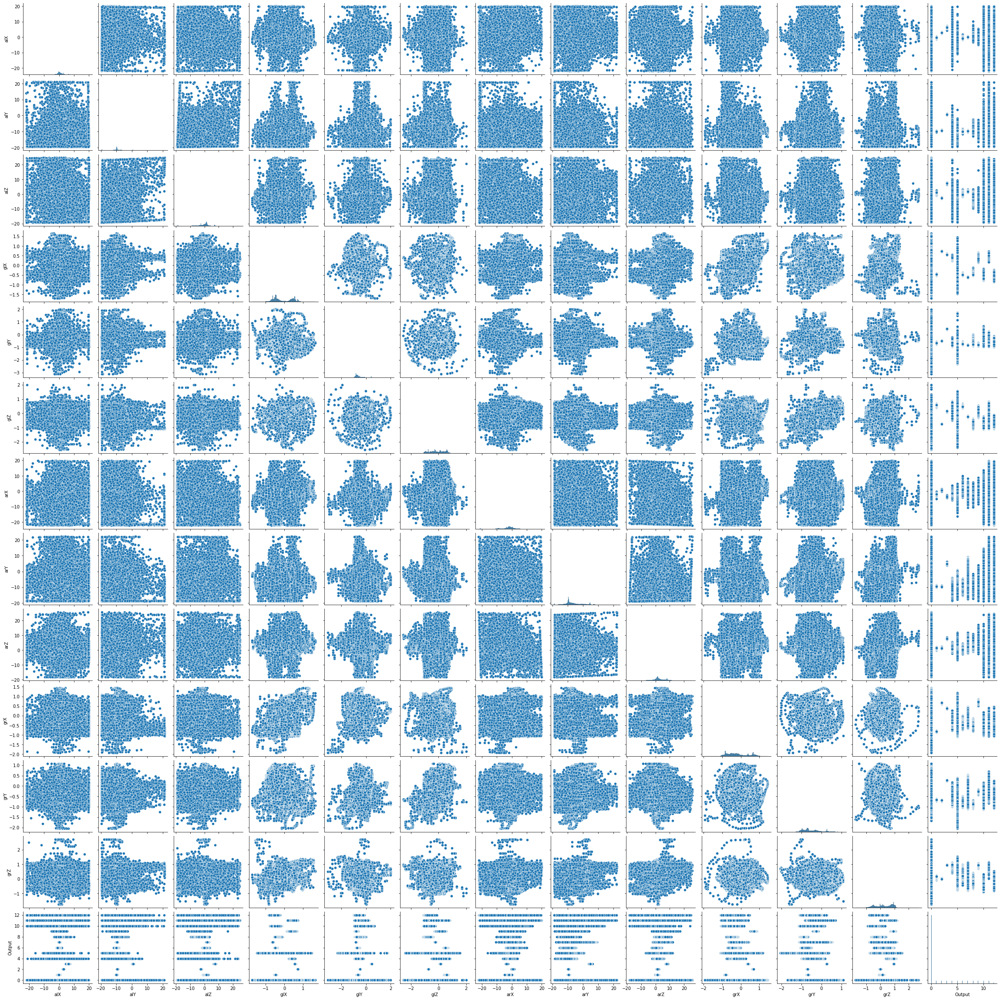

In [ ]:
sns.pairplot(mHealth)

In [ ]:
#@title Describe MHealth Dataset One Subject
mHealth.describe().T

,count,mean,std,min,25%,50%,75%,max
alX,122112.0,1.008831,3.653086,-22.0760,-0.403772,0.50284,2.007600,20.0130
alY,122112.0,-9.682334,4.404994,-19.6000,-10.505000,-9.73170,-9.050700,21.0520
alZ,122112.0,-0.838356,5.606291,-19.3650,-2.683275,0.29650,1.622325,24.8430
glX,122112.0,-0.094419,0.512585,-1.7069,-0.499070,-0.30612,0.424860,1.6494
glY,122112.0,-0.600808,0.361921,-3.1238,-0.808630,-0.69981,-0.508440,2.0113
glZ,122112.0,-0.127118,0.549091,-2.5678,-0.575640,-0.14735,0.341850,1.9941
arX,122112.0,-2.524223,5.091523,-22.3320,-4.180225,-1.79225,0.213825,19.8640
arY,122112.0,-6.315183,5.825658,-18.9720,-9.663300,-7.92870,-3.421050,22.1910
arZ,122112.0,2.710633,4.313866,-18.2300,0.576307,1.95390,5.407125,25.7350
grX,122112.0,-0.170799,0.563044,-1.9314,-0.635290,-0.27647,0.352940,1.4451


In [ ]:
#@title Describe MHealth for all
all = mHealth[mHealth["Output"] == 14].copy()

for i in os.listdir('MHEALTHDATASET/'):
  if not re.search('README', i):
    all = all.append(pd.read_csv('MHEALTHDATASET/'+i, header=None, sep='\t').loc[:, [5,6,7,8,9,10,14,15,16,17,18,19, 23]].rename(columns={5:"alX", 6:"alY", 7:"alZ", 8:"glX", 9:"glY", 10:"glZ", 14:"arX",15:"arY", 16:"arZ", 17:"grX", 18:"grY", 19:"grZ", 23:"Output"}))


description = all.describe()

description.T

,count,mean,std,min,25%,50%,75%,max
alX,1215745.0,1.494200,3.826485,-22.1460,0.14131,1.308900,2.575800,20.0540
alY,1215745.0,-9.692878,4.171303,-19.6190,-10.20100,-9.670300,-9.042200,21.1610
alZ,1215745.0,-0.954806,5.461803,-19.3730,-2.64940,-0.016456,1.301300,25.0150
glX,1215745.0,-0.001599,0.491217,-2.1466,-0.43599,-0.014842,0.448980,60.4840
glY,1215745.0,-0.616632,0.354641,-7.7899,-0.81801,-0.707320,-0.540340,2.0113
glZ,1215745.0,-0.158781,0.546798,-2.6267,-0.59332,-0.190570,0.322200,2.7701
arX,1215745.0,-3.713413,4.763586,-22.3610,-6.07600,-2.977600,-1.193700,19.8640
arY,1215745.0,-5.805526,5.757639,-18.9720,-9.40420,-7.461500,-2.533900,22.1910
arZ,1215745.0,2.393880,3.876503,-18.2390,0.12965,1.928100,4.914700,25.7410
grX,1215745.0,-0.276106,0.527689,-8.3392,-0.70588,-0.354900,0.096078,3.3196


In [ ]:
description["alX"]["max"]

20.054000000000002

In [ ]:
#@title Size of dataset for various subjects
for i in os.listdir('MHEALTHDATASET/'):
  if not re.search('README', i):
    print(pd.read_csv('MHEALTHDATASET/'+i, header=None, sep='\t').loc[:, [5,6,7,8,9,10,14,15,16,17,18,19, 23]].rename(columns={5:"alX", 6:"alY", 7:"alZ", 8:"glX", 9:"glY", 10:"glZ", 14:"arX",15:"arY", 16:"arZ", 17:"grX", 18:"grY", 19:"grZ", 23:"Output"}).shape)


(119808, 13)
(98304, 13)
(98304, 13)
(116736, 13)
(135168, 13)
(104448, 13)
(161280, 13)
(130561, 13)
(122112, 13)
(129024, 13)


In [ ]:
#@title Importing and preprocessing dataset
SAMPLES_PER_ACTIVITY=119  #@param { "type": "integer" }

Activities = [
    "Nothing",
    "Standing",
    "Sitting and Relaxing",
    "Lying Down",
    "Walking",
    "Climbing Stairs",
    "Waist bends forward",
    "Frontal Elevation of Arms",
    "Knees Bending (Crouching)",
    "Cycling",
    "Jogging",
    "Running",
    "Jump Front & Back"
    ]


NUM_ACTIVITY=len(Activities)
X = []
Y = []

FEATURES=["alX", "alY", "alZ", "glX", "glY", "glZ", "arX", "arY", "arZ", "grX", "grY", "grZ"]
ONE_HOT_ENCODED_ACTIVITY = np.eye(NUM_ACTIVITY)
for i in os.listdir('MHEALTHDATASET/'):
  if not re.search('README', i):
    temp = pd.read_csv('MHEALTHDATASET/'+i, header=None, sep='\t').loc[:, [5,6,7,8,9,10,14,15,16,17,18,19, 23]].rename(columns={5:"alX", 6:"alY", 7:"alZ", 8:"glX", 9:"glY", 10:"glZ", 14:"arX",15:"arY", 16:"arZ", 17:"grX", 18:"grY", 19:"grZ", 23:"Output"})
    for j in range(NUM_ACTIVITY):
        output = ONE_HOT_ENCODED_ACTIVITY[j]
        df =np.array(temp[temp["Output"] == j].copy())
        num_recordings = int(df.shape[0]/SAMPLES_PER_ACTIVITY)
        print(f"\tThere are {num_recordings} recordings of the {Activities[j]} activity.")
        for k in range(num_recordings):
          tensor = []
          for l in range(SAMPLES_PER_ACTIVITY):
            index = k * SAMPLES_PER_ACTIVITY + l

            tensori = []
            for m,feature in enumerate(FEATURES):
              tensori.append(df[index,m] + (description[feature]["mean"]+3*description[feature]["std"]) / (3*description[feature]["std"]))
            
            tensor.append(tensori)
          X.append(tensor)
          Y.append(output)

X = np.array(X)
Y = np.array(Y)


print("Data set parsing and preparation complete.")


	There are 721 recordings of the Nothing activity.
	There are 25 recordings of the Standing activity.
	There are 25 recordings of the Sitting and Relaxing activity.
	There are 25 recordings of the Lying Down activity.
	There are 25 recordings of the Walking activity.
	There are 25 recordings of the Climbing Stairs activity.
	There are 23 recordings of the Waist bends forward activity.
	There are 24 recordings of the Frontal Elevation of Arms activity.
	There are 22 recordings of the Knees Bending (Crouching) activity.
	There are 25 recordings of the Cycling activity.
	There are 25 recordings of the Jogging activity.
	There are 25 recordings of the Running activity.
	There are 8 recordings of the Jump Front & Back activity.
	There are 555 recordings of the Nothing activity.
	There are 25 recordings of the Standing activity.
	There are 25 recordings of the Sitting and Relaxing activity.
	There are 25 recordings of the Lying Down activity.
	There are 25 recordings of the Walking activity.

In [ ]:
X = X.reshape((X.shape[0], X.shape[1], X.shape[2], 1))

In [ ]:
!pip install --upgrade tensorflow


Requirement already up-to-date: tensorflow in /usr/local/lib/python3.6/dist-packages (2.4.1)


In [ ]:
import sklearn
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X,Y)


In [ ]:
from tensorflow.keras import layers, Sequential, Input

from sklearn.model_selection import train_test_split

In [ ]:
input_shape=X.shape[1:]

X.shape

(10126, 119, 12, 1)

In [ ]:
grumodel = Sequential(
    [
     Input(shape=input_shape),
     layers.Conv2D(64, (3,3)),
     layers.MaxPool2D((2,2)),
     layers.BatchNormalization(),  
     layers.Reshape((-1, 64)),
     layers.GRU(15),
     layers.Dense(128, activation="relu"),
     layers.Dense(13, activation="sigmoid"),

    ]

)

In [ ]:
grumodel.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

In [ ]:
import datetime
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

In [ ]:
grumodel.fit(x=X_train, 
          y=Y_train, 
          epochs=20, 
          validation_data=(X_test, Y_test), 
          callbacks=[tensorboard_callback])

Epoch 1/20
238/238 [==============================] - 38s 152ms/step - loss: 1.4290 - accuracy: 0.7124 - val_loss: 1.0303 - val_accuracy: 0.7346
Epoch 2/20
238/238 [==============================] - 37s 154ms/step - loss: 0.9428 - accuracy: 0.7337 - val_loss: 0.8422 - val_accuracy: 0.7401
Epoch 3/20
238/238 [==============================] - 35s 149ms/step - loss: 0.8120 - accuracy: 0.7555 - val_loss: 0.7891 - val_accuracy: 0.7417
Epoch 4/20
238/238 [==============================] - 34s 145ms/step - loss: 0.7723 - accuracy: 0.7566 - val_loss: 0.7419 - val_accuracy: 0.7571
Epoch 5/20
238/238 [==============================] - 35s 145ms/step - loss: 0.7381 - accuracy: 0.7442 - val_loss: 0.7088 - val_accuracy: 0.7488
Epoch 6/20
238/238 [==============================] - 35s 146ms/step - loss: 0.6546 - accuracy: 0.7694 - val_loss: 0.6659 - val_accuracy: 0.7622
Epoch 7/20
238/238 [==============================] - 35s 149ms/step - loss: 0.6196 - accuracy: 0.7651 - val_loss: 0.6029 - val_ac

In [ ]:
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>